In [1]:
# these are the imports we'll be using
%matplotlib inline
import nltk
from nltk.tokenize import word_tokenize
import glob
import matplotlib.pyplot as plt
import numpy as np
import book
import pandas
from scipy.interpolate import interp1d
plt.style.use('seaborn-white')

In [2]:
# read in all the novels in the postmodern corpus
postmodern = []

for filename in glob.glob('postmodern/*.txt'):
    try:
        postmodern.append(book.makebook(open(filename, 'r')))
    except Exception as e:
        print(book)
        
postmodern.sort(key=lambda x: x.year)

In [3]:
# word tokenize all the books we read in in the previous block
postmodern_words = []

for book in postmodern:
    postmodern_words.append(word_tokenize(book.text.strip().lower())) # strip removes string escapes
    
# now we'll make sure that things look like they were done correctly
postmodern_words[5][:6]

['a', 'screaming', 'comes', 'across', 'the', 'sky']

In [4]:
con_score = pandas.read_csv('concreteness.csv')

#transposes, then converts to ndarray
con_score = con_score[['Word','Conc.M']].sort_values(by='Word').T.values

def get_score(word):
    try:
        return con_score[1][int(np.where(con_score == word)[1])]
    except:
        return np.nan

# should return 5.0
get_score('bat')

5.0

In [5]:
a = []
samplesize = 500

for book in postmodern_words:
    a.append(np.nanmean(np.array([get_score(word) for word in np.random.choice(book,samplesize)])))


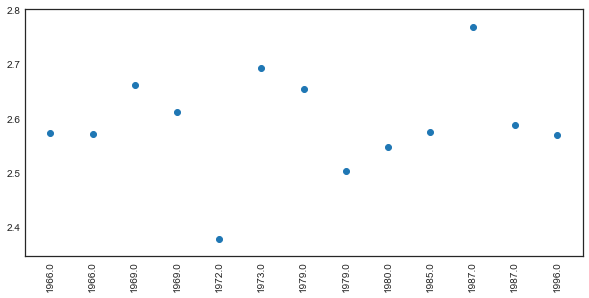

2.59177634038


In [ ]:
dates = [book.year for book in postmodern]
x = np.arange(len(dates))
y = np.array(a)
xlabel = dates

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(211)
ax.scatter(x,y)
plt.xticks(x, dates, rotation='vertical')
plt.show()
print(np.mean(a))

In [ ]:
post911 = []
a = []

for filename in glob.glob('post911/*.txt'):
    try:
        post911.append(book.makebook(open(filename, 'r')))
    except Exception as e:
        print(book)

post911_words = []

for book in post911:
    post911_words.append(word_tokenize(book.text.strip())) 
    
post911.sort(key=lambda x: x.year)

for book in post911_words:
    a.append(np.nanmean(np.array([get_score(word) for word in np.random.choice(book,samplesize)])))

dates = [book.year for book in post911]
x = np.arange(len(dates))
y = np.array(a)
xlabel = dates

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(211)
ax.scatter(x,y)
plt.xticks(x, dates, rotation='vertical')
plt.show()
print(np.mean(a))

['i', 'am', 'seated', 'in', 'an', 'office', ',', 'surrounded', 'by', 'heads', 'and', 'bodies', '.', 'my', 'posture', 'is', 'consciously', 'congruent', 'to', 'the', 'shape', 'of', 'my', 'hard', 'chair', '.', 'this', 'is', 'a', 'cold', 'room', 'in', 'university', 'administration', ',', 'wood-walled', ',', 'remington-hung', ',', 'double-windowed', 'against', 'the', 'november', 'heat', ',', 'insulated', 'from', 'administrative', 'sounds', 'by', 'the', 'reception', 'area', 'outside', ',', 'at', 'which', 'uncle', 'charles', ',', 'mr.', 'delint', 'and', 'i', 'were', 'lately', 'received', '.', 'i', 'am', 'in', 'here', '.', 'three', 'faces', 'have', 'resolved', 'into', 'place', 'above', 'summer-weight', 'sportcoats', 'and', 'half-windsors', 'across', 'a', 'polished', 'pine', 'conference', 'table', 'shiny', 'with', 'the', 'spidered', 'light', 'of', 'an', 'arizona', 'noon', '.', 'these', 'are', 'three', 'deans', '—', 'of', 'admissions', ',', 'academic', 'affairs', ',', 'athletic', 'affairs', '.',